In [2]:
# bob.static {"token": "98a517f5b880eeda7ed8568d7e8fb77834ac95284fede5c0459b5d2f8192", "path": "/home/ftp/ftp/dev/wsr-public/data_output/Confirmed.html", "filename": "../data_output/Confirmed.html"} 
# bob.static {"token": "7d0fe7cd6483514da087ccf755b574964d799167e7fa5a18962e5772b5c9", "path": "/home/ftp/ftp/dev/wsr-public/data_output/Confirmed Rate.html", "filename": "../data_output/Confirmed Rate.html"} 
# bob.static {"token": "efd045150687448d5dbdc2c0acb3e51b05e4ba28d2d29f4d533f29c14c2b", "path": "/home/ftp/ftp/dev/wsr-public/data_output/Deaths.html", "filename": "../data_output/Deaths.html"} 
# bob.static {"token": "d14c73baee025b68caae42cb577dbef7c665e74e0fa1b89458ea52a9aa3e", "path": "/home/ftp/ftp/dev/wsr-public/data_output/Fatality Rate.html", "filename": "../data_output/Fatality Rate.html"}

In [3]:
%run __init__.ipynb

Successfully connected to MongoDB


In [4]:
#--Create Dataframe
cUS=pd.read_csv(output_folder + 'US_CONFIRMED.csv',sep=";").drop('Unnamed: 0',axis=1)
cols_to_keep=['UID','iso2', 'iso3','code3','FIPS','Admin2','Lat','Long_','Combined_Key','Province_State','Country_Region']
cUS= cUS.melt(id_vars=cols_to_keep,value_name='Confirmed',var_name='Date').groupby(['Date','Province_State'], as_index=False).agg({'Confirmed':'sum'})

dUS=pd.read_csv(output_folder + 'US_DEATHS.csv',sep=";").drop('Unnamed: 0',axis=1)
cols_to_keep=['UID','iso2', 'iso3','code3','FIPS','Admin2','Lat','Long_','Combined_Key','Province_State','Country_Region','Population']
dUS= dUS.melt(id_vars=cols_to_keep,value_name='Deaths',var_name='Date').groupby(['Date','Province_State'], as_index=False).agg({'Deaths':'sum','Population':'sum'})

dfUS=pd.merge(cUS,dUS, on=['Date','Province_State'], how='left').reset_index(drop=True)
dfUS.loc[(dfUS['Deaths'] != 0),'Fatality Rate'] = round((dfUS['Deaths']/dfUS['Confirmed']*100),2)
dfUS.loc[(dfUS['Confirmed'] != 0),'Confirmed Rate'] = round((dfUS['Confirmed']/dfUS['Population']*100),2)
dfUS.loc[(dfUS['Deaths'] != 0),'Deaths Rate'] = round((dfUS['Deaths']/dfUS['Population']*100),2)

dfUS['Date'] = pd.to_datetime(dfUS['Date'], format='%m/%d/%y').dt.strftime('%m/%d/%y')
dfUSanim = dfUS[(dfUS['Population'] != 0) & (dfUS['Confirmed'] != 0)]
dfUS = dfUS[(dfUS['Date'] == yesterday.strftime('%m/%d/%y')) & (dfUS['Population'] != 0) & (dfUS['Confirmed'] != 0)]
dfUS

,Date,Province_State,Confirmed,Deaths,Population,Fatality Rate,Confirmed Rate,Deaths Rate
4408,04/15/20,Alabama,4075,118.0,4903185,2.90,0.08,0.00
4409,04/15/20,Alaska,293,9.0,731545,3.07,0.04,0.00
4411,04/15/20,Arizona,3964,142.0,7278717,3.58,0.05,0.00
4412,04/15/20,Arkansas,1569,33.0,3017804,2.10,0.05,0.00
4413,04/15/20,California,26686,861.0,39512223,3.23,0.07,0.00
4414,04/15/20,Colorado,7956,328.0,5758736,4.12,0.14,0.01
4415,04/15/20,Connecticut,14755,868.0,3565287,5.88,0.41,0.02
4416,04/15/20,Delaware,2014,46.0,973764,2.28,0.21,0.00
4418,04/15/20,District of Columbia,2197,72.0,705749,3.28,0.31,0.01
4419,04/15/20,Florida,22511,596.0,21477737,2.65,0.10,0.00


In [5]:
# test = dfUS[dfUS['Province_State'] == 'New York']
# test

In [6]:
def analysis(variable):
    Min = dfUS[variable].min()
    Max = dfUS[variable].max()
    Avr = round(dfUS[variable].mean(),0)
    Sum = dfUS[variable].sum()
    to_print = f'{variable} : Min: {Min}, Max: {Max}, Average: {Avr}, Sum: {Sum}'
    return print(to_print)

In [7]:
def create_map(df,geo,kpi,scale,colors):
    fig = px.choropleth_mapbox(df, geojson=geo, color=kpi,
                               locations="Province_State", featureidkey="properties.NAME",
                               range_color=scale,
                               color_continuous_scale=colors,
#                                animation_frame="Date",
                               mapbox_style="carto-positron", 
                               zoom=3, center={"lat": 37.0902, "lon": -95.7129},
                               labels={'Province_State':'State'}
                              )
    fig.write_html(output_folder + kpi + ".html")
#     bob.makeStaticGettable(output_folder + kpi + ".html","dev")
    return fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

Confirmed : Min: 13, Max: 214454, Average: 11567.0, Sum: 636198


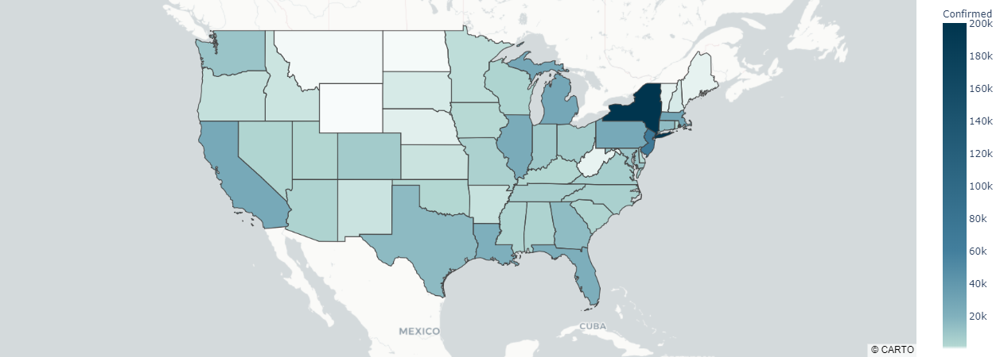

In [9]:
#Confirmed
kpi='Confirmed'
scale = (100,200000)
colors = [
    [0.0, "#FFFFFF"],
    [0.01,"#B3D7D2"],
    [0.1, "#81B1BD"],
    [0.3, "#437F9D"],
    [1.0, "#00354E"]
]
analysis(kpi)
create_map(dfUS,states20m,kpi,scale,colors)

# fig = px.choropleth_mapbox(dfUSanim, geojson=states20m, color=kpi,
#                                locations="Province_State", featureidkey="properties.NAME",
#                                range_color=scale,
#                                color_continuous_scale=colors,
#                                animation_frame="Date",
#                                mapbox_style="carto-positron", 
#                                zoom=3, center={"lat": 37.0902, "lon": -95.7129},
#                                labels={'Province_State':'State'}
#                             )
# fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
# fig.show

Confirmed Rate : Min: 0.02, Max: 0.91, Average: 0.0, Sum: 7.749999999999999


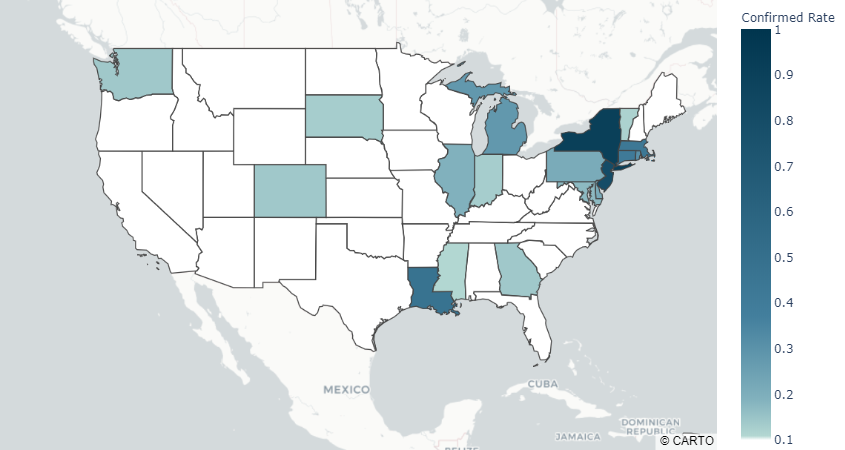

In [80]:
#Confirmed Rate
colors = [
    [0.0, "#FFFFFF"],
    [0.01,"#B3D7D2"],
    [0.1, "#81B1BD"],
    [0.3, "#437F9D"],
    [1.0, "#00354E"]
]
scale = (0.1,1)
kpi='Confirmed Rate'
analysis(kpi)
create_map(dfUS,states20m,kpi,scale,colors)

Deaths : Min: 1.0, Max: 11617.0, Average: 515.0, Sum: 28326.0


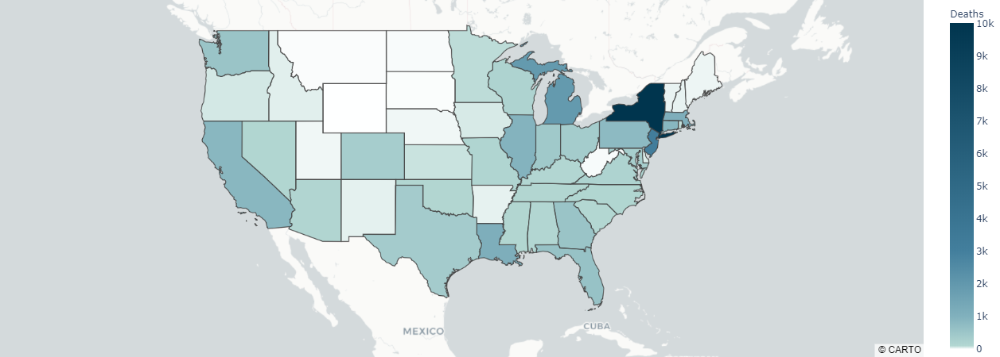

In [10]:
#'Deaths'
colors = [
    [0.0, "#FFFFFF"],
    [0.01,"#B3D7D2"],
    [0.1, "#81B1BD"],
    [0.3, "#437F9D"],
    [1.0, "#00354E"]
]
scale = (0,10000)
kpi='Deaths'
analysis(kpi)
create_map(dfUS,states20m,kpi,scale,colors)

Fatality Rate : Min: 0.35, Max: 15.38, Average: 4.0, Sum: 196.35


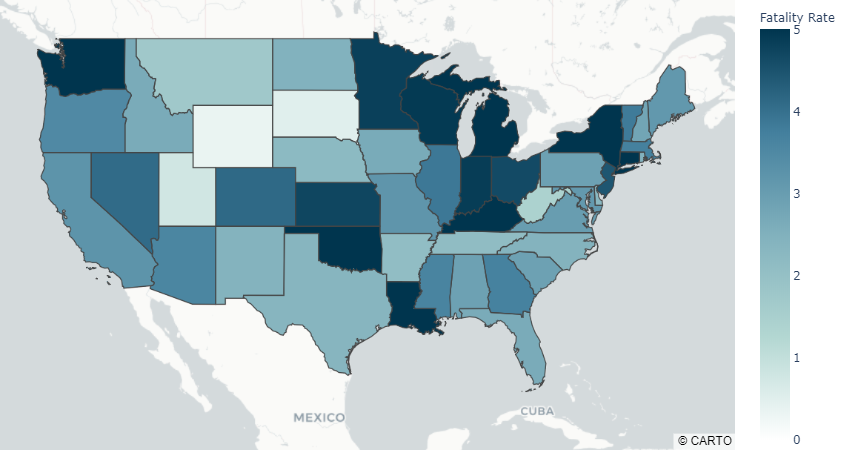

In [82]:
#Fatality Rate
colors = [
    [0.0, "#FFFFFF"],
    [0.25,"#B3D7D2"],
    [0.5, "#81B1BD"],
    [0.75, "#437F9D"],
    [1.0, "#00354E"]
]
scale = (0,5)
kpi='Fatality Rate'
analysis(kpi)
create_map(dfUS,states20m,kpi,scale,colors)

In [70]:
#html
confirmed = [{'URL' : 'https://api.dev.cashstory.com/api/v1/notebook/bob_40cashstory_2Ecom/98a517f5b880eeda7ed8568d7e8fb77834ac95284fede5c0459b5d2f8192', 'KPI' : 'Confirmed'}]
confirmedRate = [{'URL' : 'https://api.dev.cashstory.com/api/v1/notebook/bob_40cashstory_2Ecom/7d0fe7cd6483514da087ccf755b574964d799167e7fa5a18962e5772b5c9', 'KPI' : 'Confirmed Rate'}]
deaths = [{'URL' : 'https://api.dev.cashstory.com/api/v1/notebook/bob_40cashstory_2Ecom/efd045150687448d5dbdc2c0acb3e51b05e4ba28d2d29f4d533f29c14c2b', 'KPI' : 'Deaths'}]
fatalityRate = [{'URL' :'https://api.dev.cashstory.com/api/v1/notebook/bob_40cashstory_2Ecom/d14c73baee025b68caae42cb577dbef7c665e74e0fa1b89458ea52a9aa3e', 'KPI' : 'Fatality Rate'}]

list_kpis = confirmed + confirmedRate + deaths + fatalityRate
domain = pd.DataFrame(list_kpis)
domain.loc[:,'VALUE'] = """<iframe src='"""+ domain['URL'] +"""' frameborder='0' style='overflow:hidden;height:85vh;width:100%' height='100%' width='100%'></iframe> <style>.modebar{display: none!important;}</style>"""
bob.mongo.save_df(domain,'109',db_app,True)
domain

Dataframe 109 successfully save in database app-wsr-dev in MongoDB. Time: --- 0.020593881607055664 secnds ---


,URL,KPI,VALUE
0,https://api.dev.cashstory.com/api/v1/notebook/...,Confirmed,<iframe src='https://api.dev.cashstory.com/api...
1,https://api.dev.cashstory.com/api/v1/notebook/...,Confirmed Rate,<iframe src='https://api.dev.cashstory.com/api...
2,https://api.dev.cashstory.com/api/v1/notebook/...,Deaths,<iframe src='https://api.dev.cashstory.com/api...
3,https://api.dev.cashstory.com/api/v1/notebook/...,Fatality Rate,<iframe src='https://api.dev.cashstory.com/api...
